In [69]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import  train_test_split
from sklearn.metrics import roc_auc_score, plot_roc_curve, plot_confusion_matrix
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV

In [3]:
# get data

data = pd.read_csv('./data/creditcard.csv')

In [4]:
data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [5]:
# Data Shape
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [37]:
# Case counts
counts = data.Class.value_counts().tolist()
#fraud_count, non_fraud-count = values
print ("Fraud cases {}, fraud-percentage {}".format(counts[1], round(counts[1]/data.shape[0], 4)))
print ("Non Fraud cases {}, non fraud-percentage {}".format(counts[0], round(counts[0]/data.shape[0], 4)))

Fraud cases 492, fraud-percentage 0.0017
Non Fraud cases 284315, non fraud-percentage 0.9983


<BarContainer object of 2 artists>

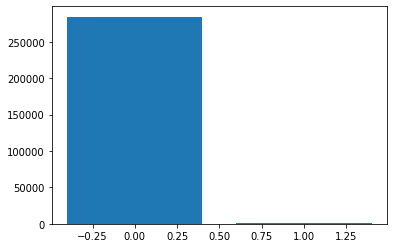

In [39]:
# Barplot of class distribution
plt.bar( data.Class.unique(), data.Class.value_counts())

In [41]:
for i in range(0,1):    
    print(data[data.Class == i].describe())

                Time             V1             V2             V3  \
count  284315.000000  284315.000000  284315.000000  284315.000000   
mean    94838.202258       0.008258      -0.006271       0.012171   
std     47484.015786       1.929814       1.636146       1.459429   
min         0.000000     -56.407510     -72.715728     -48.325589   
25%     54230.000000      -0.917544      -0.599473      -0.884541   
50%     84711.000000       0.020023       0.064070       0.182158   
75%    139333.000000       1.316218       0.800446       1.028372   
max    172792.000000       2.454930      18.902453       9.382558   

                  V4             V5             V6             V7  \
count  284315.000000  284315.000000  284315.000000  284315.000000   
mean       -0.007860       0.005453       0.002419       0.009637   
std         1.399333       1.356952       1.329913       1.178812   
min        -5.683171    -113.743307     -26.160506     -31.764946   
25%        -0.850077      -0.6893

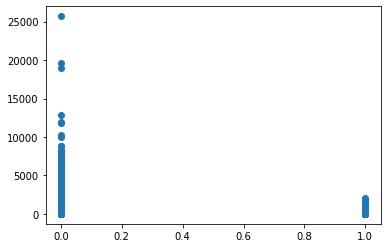

In [68]:
plt.scatter(data.Class, data.Amount)
plt.show()

In [76]:
data.Amount.describe()

count    284807.000000
mean         88.349619
std         250.120109
min           0.000000
25%           5.600000
50%          22.000000
75%          77.165000
max       25691.160000
Name: Amount, dtype: float64

In [60]:
# Train test split
features = data.drop(['Class','Amount'], axis=1)
labels = data.Class

x_train, x_test, y_train, y_test = train_test_split(features, labels, test_size = 0.2, stratify=labels,  random_state = 1)


In [61]:
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((227845, 29), (56962, 29), (227845,), (56962,))

In [62]:
len(y_train[y_train == 0]), len(y_train[y_train == 1])

(227451, 394)

In [63]:
len(y_test[y_test == 0]), len(y_test[y_test == 1])

(56864, 98)

### Modelling

In [64]:


lr = LogisticRegression()
lr.fit(x_train, y_train)

roc_auc_score(y_train, lr.predict(x_train))

LogisticRegression()

0.8925493910282176


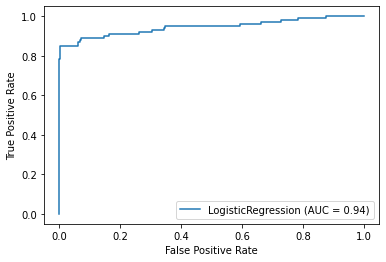

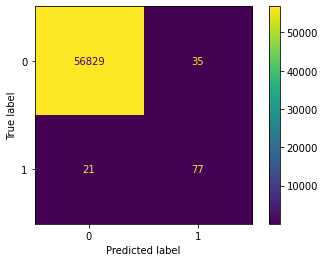

In [74]:
output(lr, x_test, y_test)

In [77]:
# test score
def output(model, x_test, y_test):
    print(roc_auc_score(y_test,model.predict(x_test)))
    plot_roc_curve(model, x_test, y_test)
    plot_confusion_matrix(model, x_test, y_test)

0.8925493910282176


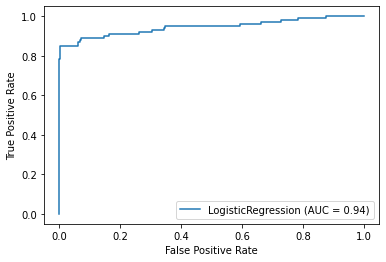

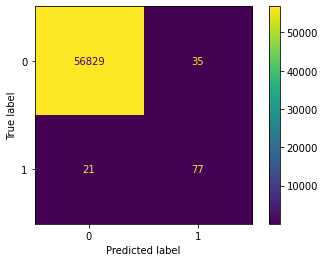

In [75]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier().fit(x_train, y_train)

output(rf, x_test, y_test)